In [10]:
import os, json, random
import pandas as pd
from pathlib import Path
from PIL import Image
from alive_progress import alive_bar

while ".git" not in os.listdir(os.getcwd()): prj_dir = os.chdir(Path(os.getcwd())/"..")

from utils.boxes import rxyxy2xywh, xywh2xy_xy

In [2]:
source_name = 'dota'
data_folder = Path(f'data/sources/{source_name}')
subfolders = ['train', 'val']

In [12]:
img_infos = [{'file_name': str(data_folder/'images'/sf/f), 'sf': sf, 'b': Path(f).stem } for sf in subfolders for f in os.listdir(data_folder/'images'/sf)]

with alive_bar(len(img_infos)) as bar:
    for i in img_infos:
        im = Image.open(i['file_name'])
        f = data_folder/"labels"/i['sf']/f"{i['b']}.txt"
        i['annotations'] = []
        try:
            annotations_df = pd.read_csv(f, sep=" ", header=None)
            for index, row in annotations_df.iterrows():
                category = row[0]
                if category in [9, 10]:
                    bbox = [min(row[range(1, 9, 2)]), min(row[range(2, 9, 2)]), max(row[range(1, 9, 2)]), max(row[range(2, 9, 2)])]
                    i['annotations'].append({
                        'category': category,
                        'org': list(row.values),
                        'bbox': rxyxy2xywh(bbox, im.size)
                    })
        except Exception as e:
            print(f"{f}: {e}")
        bar()

on 763: data/sources/dota/labels/train/P1531.txt: No columns to parse from file
|████████████████████████████████████████| 1869/1869 [100%] in 3:44.5 (8.32/s) 


In [13]:
with open(f'data/unified/sources/{source_name}.json', 'w') as f:
    json.dump(img_infos, f)

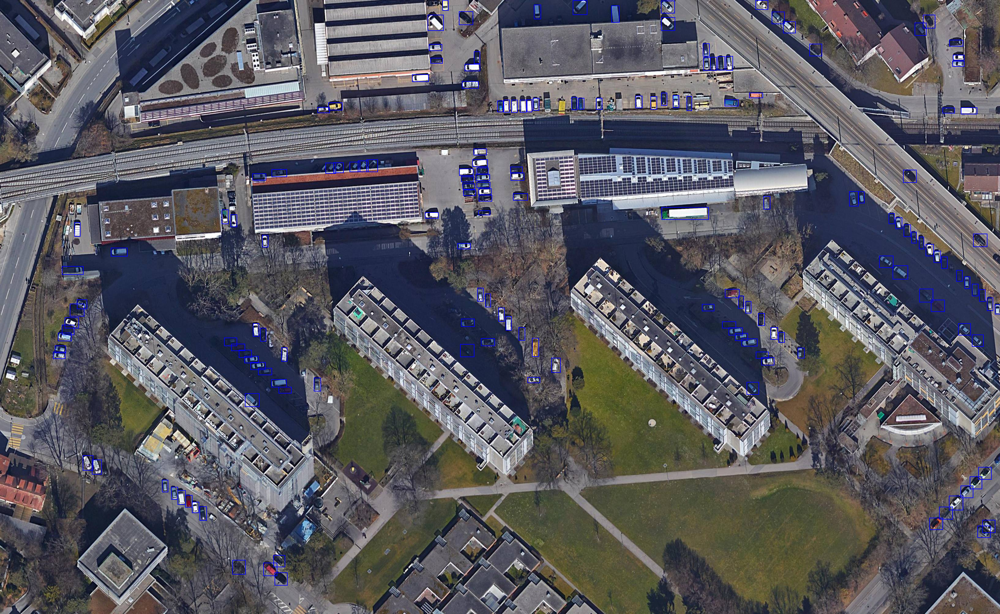

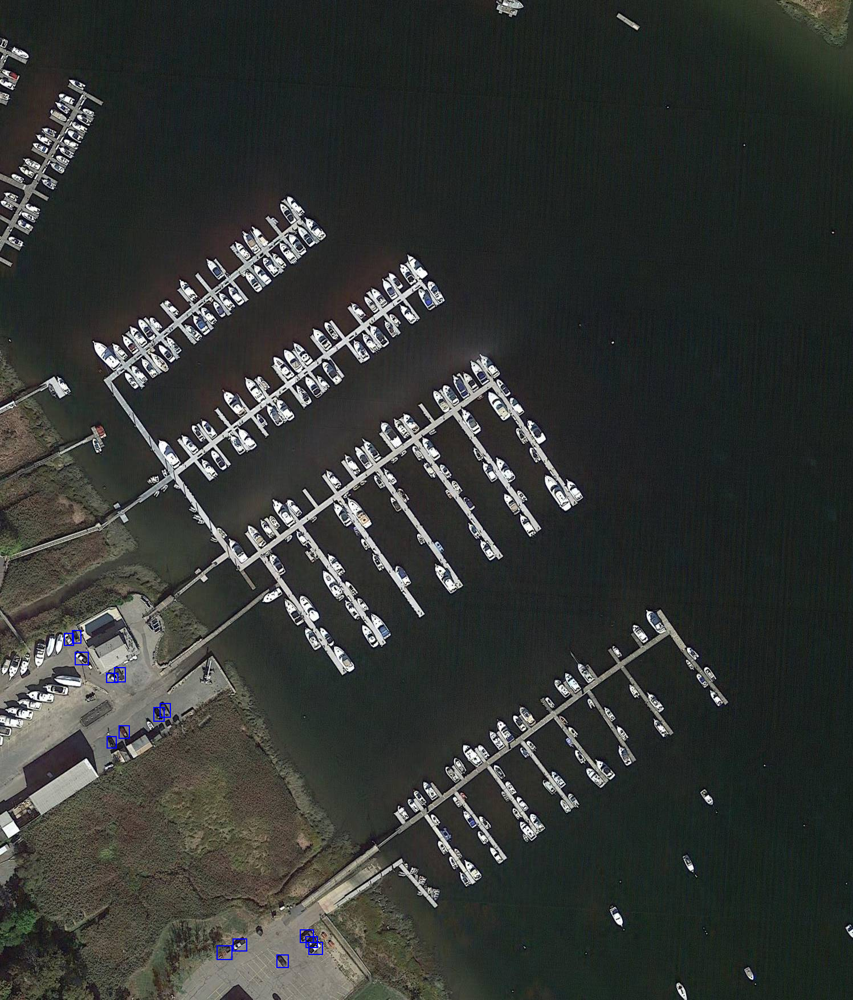

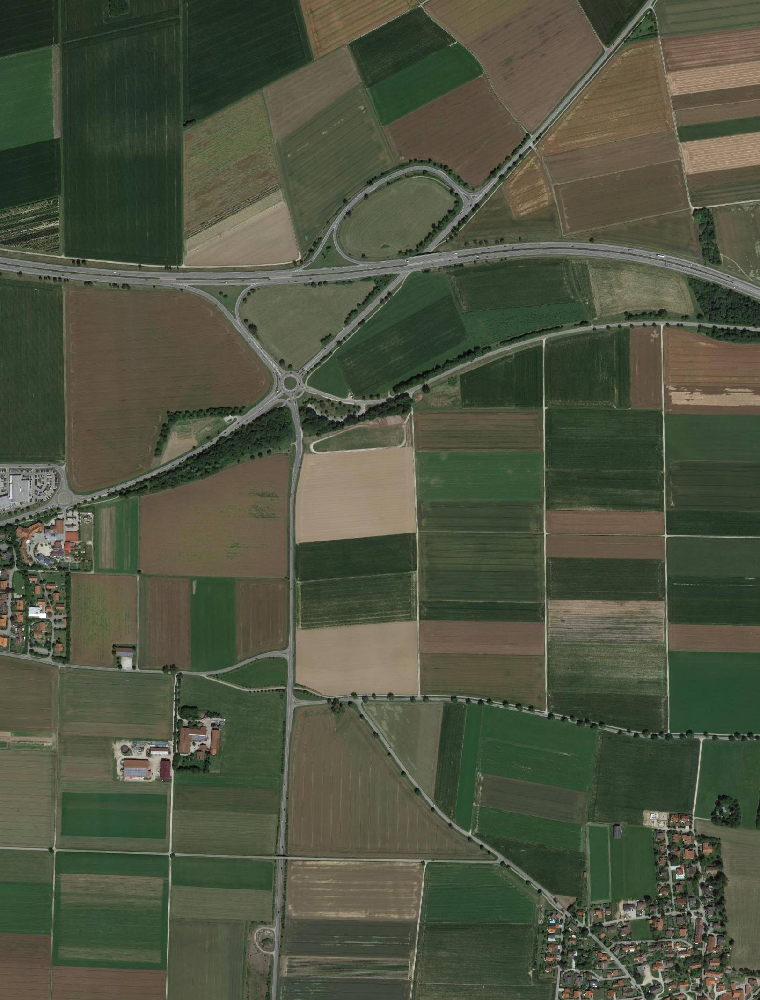

In [14]:
from PIL import Image, ImageDraw
import numpy as np

def drawTest(img_info):
    img = Image.open(img_info['file_name'])
    draw = ImageDraw.Draw(img)
    # print(img.size)

    for a in img_info['annotations']:
        # row = np.array(a['org'])
        # bbox = [min(row[range(1, 9, 2)]), min(row[range(2, 9, 2)]), max(row[range(1, 9, 2)]), max(row[range(2, 9, 2)])]
        # print(a['org'])
        # print(bbox)
        # print(rxyxy2xywh(bbox, img.size))
        # print(a['bbox'])
        draw.rectangle(xywh2xy_xy(a['bbox']), outline="blue",  width=2)
        # draw.polygon(a['polygon'], outline="red",  width=2)

    display(img)    


i_s = list(range(len(img_infos)))
random.shuffle(i_s)

for i in range(3):
    k = i_s[i]
    img_info = img_infos[k]
    drawTest(img_info)